<a href="https://colab.research.google.com/github/Venkatasai25/license-plate-recognition/blob/main/license_plate_dtection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

License Plate Detection and OCR Processing


In this Jupyter notebook, we guide you through the comprehensive process of building a computer vision application with LandingLens that detects and reads license plates from videos. Each section is crafted to provide you with a conceptual understanding of the step in the process and practical code examples. The process starts with frame extraction, followed by the detection and cropping of license plates, and finally, optical character recognition (OCR) for data retrieval.

By the end of this notebook, not only will you have a functioning license plate reader, but you'll also possess foundational knowledge and techniques that are transferable to a myriad of other computer vision applications. Whether you're aiming to recognize faces, track objects, or read text from images, the principles and methods showcased here will serve as a valuable cornerstone for your future projects.

In [1]:
#installation
!pip install landingai gdown

!gdown "https://drive.google.com/uc?id=16iwE7mcz9zHqKCw2ilx0QEwSCjDdXEW4" -O /tmp/license-plates.mov
# adding instance
from IPython.display import Video
Video("https://drive.google.com/uc?export=view&id=16iwE7mcz9zHqKCw2ilx0QEwSCjDdXEW4", width=512)
#check with frames
from landingai.pipeline.image_source import VideoFile

# Replace 'path_to_video_file' with the actual path to your video file
# video_file_path = '/Users/whit_blodgett/Desktop/Code/landing-apps-poc/license_plate_ocr_app/IMG_2464.MOV'
video_file_path = "/tmp/license-plates.mov"

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.3/49.3 kB 882.4 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 17.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 276.6/276.6 kB 19.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.9/143.9 kB 11.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 59.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 288.7/288.7 kB 14.6 MB/s eta 0:00:00
  Attempting uninstall: urllib3
    Found existing installation: urllib3 2.0.7
    Uninstalling urllib3-2.0.7:
      Successfully uninstalled urllib3-2.0.7
Downloading...
From: https://drive.google.com/uc?id=16iwE7mcz9zHqKCw2ilx0QEwSCjDdXEW4
To: /tmp/license-plates.mov
100% 24.6M/24.6M [00:01<00:00, 15.5MB/s]


Extracted 23 frames in 20.18 seconds


/usr/local/lib/python3.10/dist-packages/landingai/pipeline/image_source.py:222: UserWarning: VideoFile object should be closed explicitly with close(), or using 'with' statement.
  warnings.warn(


Frame extraction time: 20.180790185928345
License plate detection times: [1.6804640293121338, 1.2310030460357666, 0.7384324073791504, 0.7496242523193359, 0.7431759834289551, 0.7482771873474121, 0.5906853675842285, 0.7465777397155762, 0.7354471683502197, 0.590815544128418, 0.7311973571777344, 0.7369301319122314, 1.2219128608703613, 0.7328462600708008, 0.7416040897369385, 0.7461855411529541, 0.5891127586364746, 0.6122889518737793, 0.7597146034240723, 0.5970523357391357, 0.7485110759735107, 0.7469284534454346, 1.2276227474212646]
Cropping times: [0.00016355514526367188, 0.00017118453979492188, 1.6689300537109375e-06, 4.76837158203125e-07, 2.384185791015625e-07, 6.67572021484375e-05, 7.152557373046875e-07, 5.245208740234375e-05, 5.316734313964844e-05, 6.4849853515625e-05, 4.76837158203125e-07, 2.765655517578125e-05, 3.24249267578125e-05, 4.76837158203125e-07, 2.384185791015625e-07, 4.172325134277344e-05, 4.57763671875e-05, 4.76837158203125e-07, 2.384185791015625e-07, 4.76837158203125e-07, 

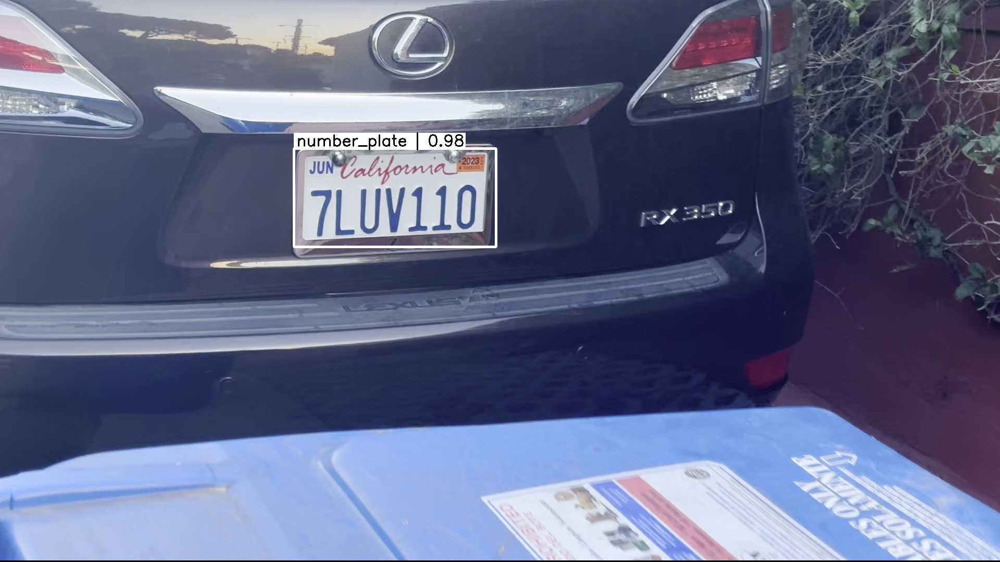

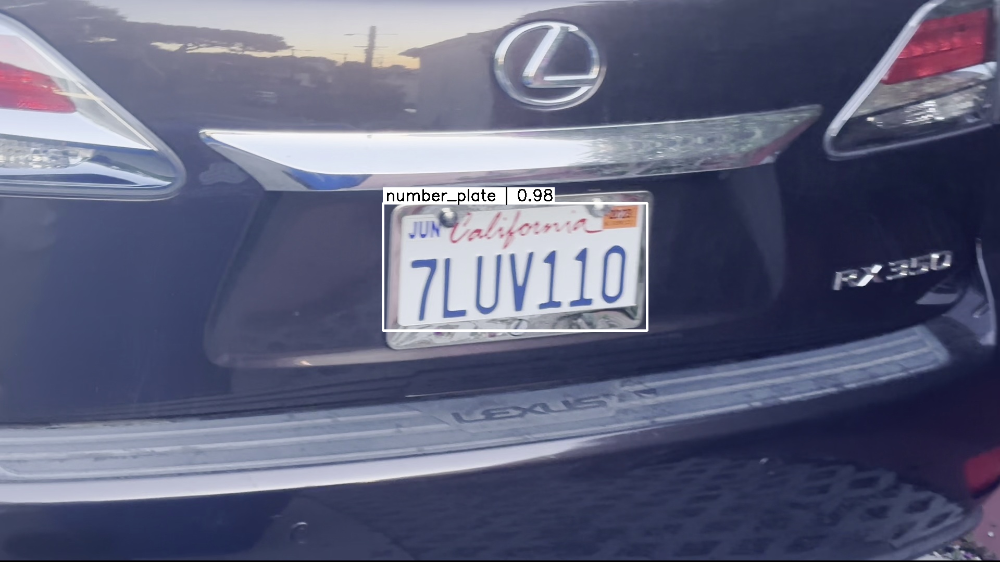

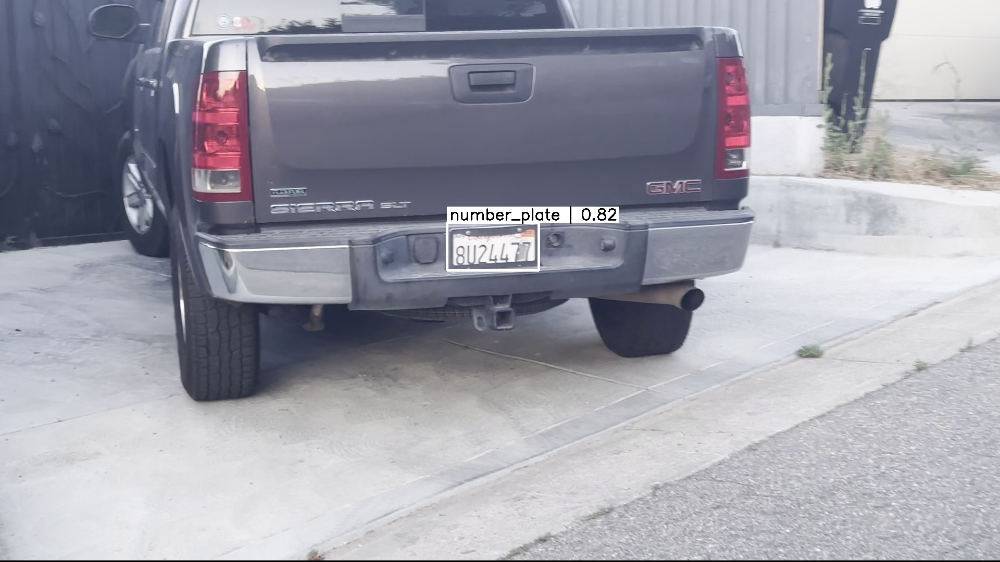

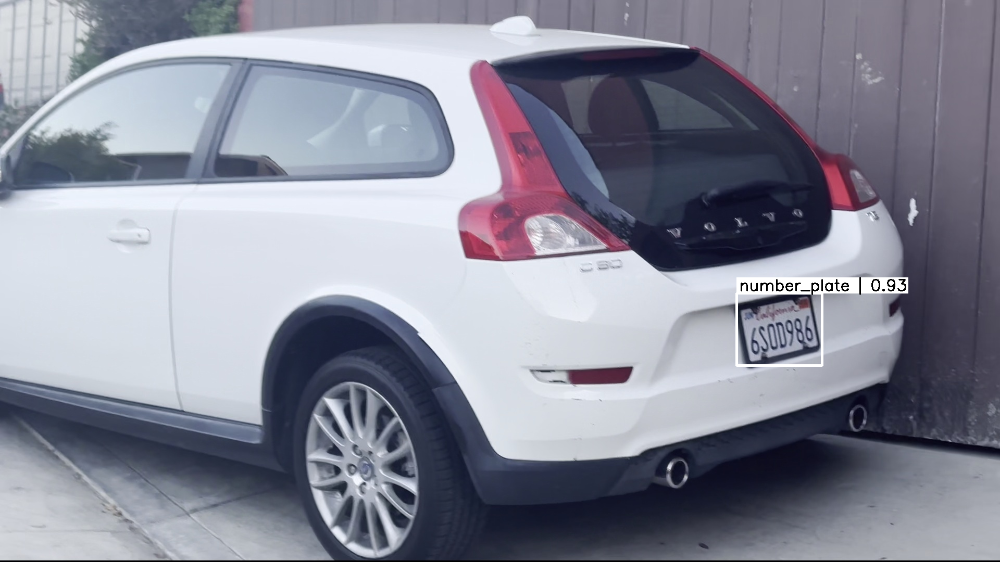

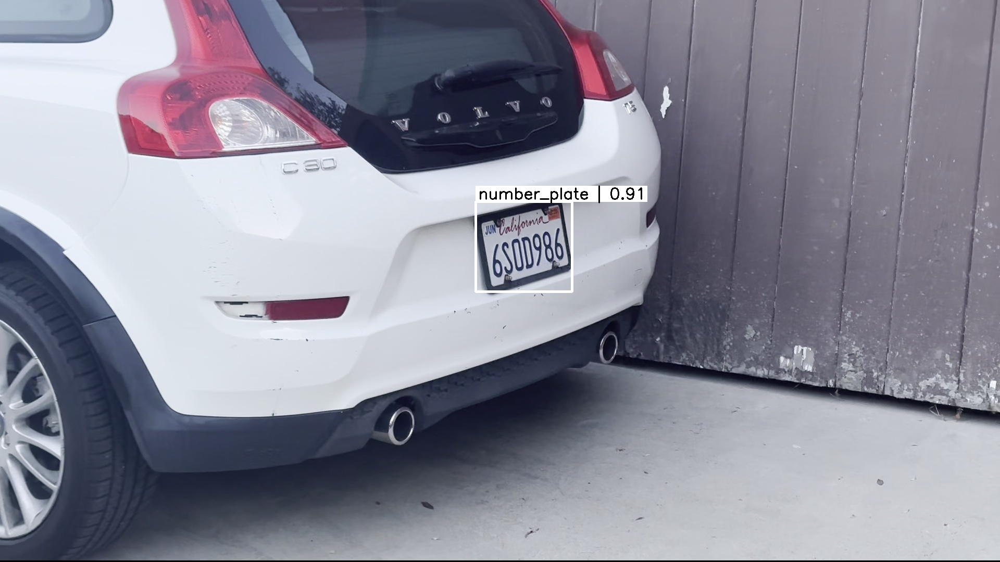

...

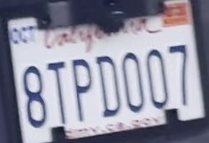

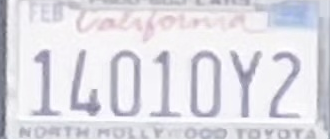

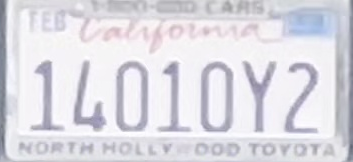

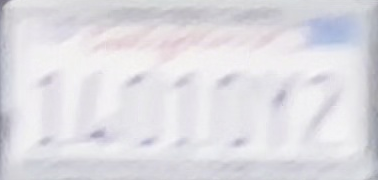

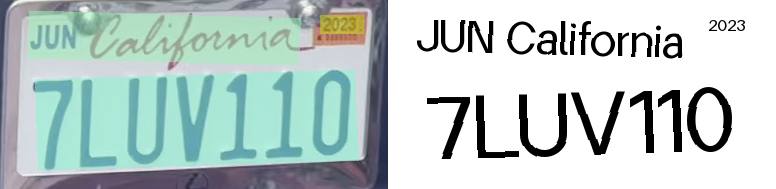

2023
7LUV110
JUN California


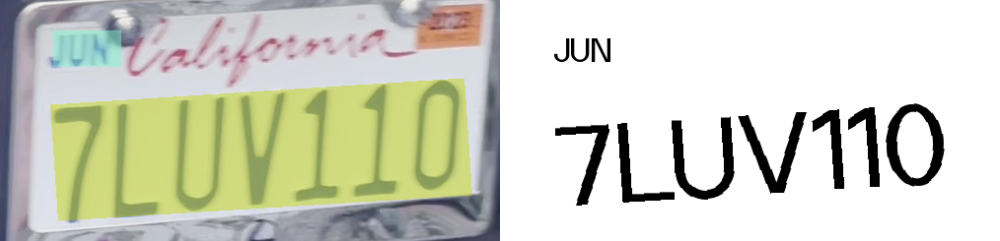

7LUV110
JUN


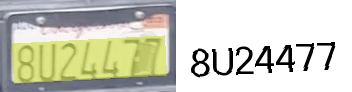

8U24477


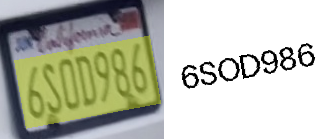

6SOD986


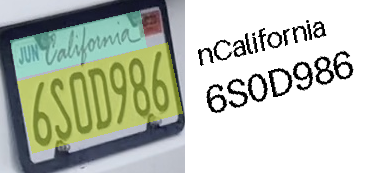

6S0D986
nCalifornia


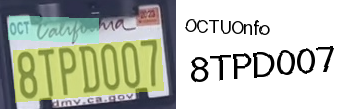

8TPD007
OCTUOnfo


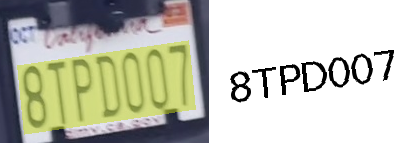

8TPD007


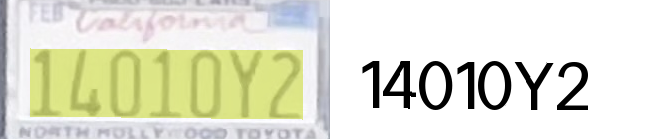

14010Y2


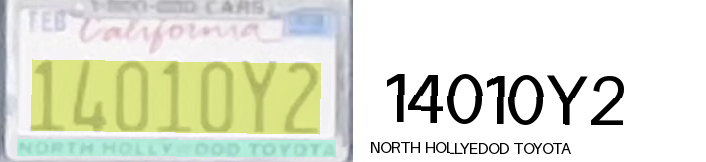

14010Y2
NORTH HOLLYEDOD TOYOTA


In [2]:
import time
from IPython.display import display, Video
from landingai.pipeline.image_source import VideoFile
from landingai.predict import Predictor, OcrPredictor
from landingai import visualize
from landingai.postprocess import crop

# Function to extract frames
def extract_frames(video_path, samples_per_second=1):
    start_time = time.time()
    video_source = VideoFile(video_path, samples_per_second=samples_per_second)
    frames = [f.image for f in video_source]
    extraction_time = time.time() - start_time
    print(f"Extracted {len(frames)} frames in {extraction_time:.2f} seconds")
    return frames, extraction_time

# Function to detect license plates
def detect_license_plates(frames, model_endpoint, api_key):
    predictor = Predictor(model_endpoint, api_key=api_key)
    bounding_boxes = []
    overlayed_frames = []
    detection_times = []

    for frame in frames:
        start_time = time.time()
        prediction = predictor.predict(frame)
        detection_time = time.time() - start_time
        detection_times.append(detection_time)

        overlay = visualize.overlay_predictions(prediction, frame)
        bounding_boxes.append(prediction)
        overlayed_frames.append(overlay)

    return bounding_boxes, overlayed_frames, detection_times

# Function to crop license plates
def crop_license_plates(frames, bounding_boxes):
    cropped_imgs = []
    crop_times = []

    for frame, bboxes in zip(frames, bounding_boxes):
        start_time = time.time()
        cropped = crop(bboxes, frame)
        crop_time = time.time() - start_time
        crop_times.append(crop_time)
        cropped_imgs.append(cropped)

    return cropped_imgs, crop_times

# Function to perform OCR
def perform_ocr(cropped_imgs, api_key):
    ocr_predictor = OcrPredictor(api_key=api_key)
    ocr_preds = []
    overlayed_ocr = []
    ocr_times = []

    for frame in cropped_imgs:
        for plate in frame:
            start_time = time.time()
            ocr_pred = ocr_predictor.predict(plate)
            ocr_time = time.time() - start_time
            ocr_times.append(ocr_time)

            ocr_preds.append(ocr_pred)
            overlay = visualize.overlay_predictions(ocr_pred, plate)
            overlayed_ocr.append(overlay)

    return ocr_preds, overlayed_ocr, ocr_times

# Main process
video_file_path = "/tmp/license-plates.mov"
frames, extraction_time = extract_frames(video_file_path, samples_per_second=1)
api_key_detection = "land_sk_aMemWbpd41yXnQ0tXvZMh59ISgRuKNRKjJEIUHnkiH32NBJAwf"
model_endpoint = "e001c156-5de0-43f3-9991-f19699b31202"
bounding_boxes, overlayed_frames, detection_times = detect_license_plates(frames, model_endpoint, api_key_detection)
cropped_imgs, crop_times = crop_license_plates(frames, bounding_boxes)
api_key_ocr = "land_sk_WVYwP00xA3iXely2vuar6YUDZ3MJT9yLX6oW5noUkwICzYLiDV"
ocr_preds, overlayed_ocr, ocr_times = perform_ocr(cropped_imgs, api_key_ocr)

# Display times for each step
print("Frame extraction time:", extraction_time)
print("License plate detection times:", detection_times)
print("Cropping times:", crop_times)
print("OCR times:", ocr_times)

# Display results
for i, frame in enumerate(overlayed_frames):
    if len(bounding_boxes[i]) == 0:
        continue
    display(frame)

for i, cropped in enumerate(cropped_imgs):
    if len(cropped) == 0:
        continue
    for plate in cropped:
        display(plate)

for frame, ocr_pred in zip(overlayed_ocr, ocr_preds):
    if len(ocr_pred) == 0:
        continue
    display(frame)
    for text in ocr_pred:
        print(text.text)